In [ ]:
!pip install -q kaggle

In [ ]:
from google.colab import files
files.upload()

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d indahauliasahira/tim-bucin-kelompok-22

 98% 225M/229M [00:19<00:00, 26.7MB/s]
100% 229M/229M [00:19<00:00, 12.6MB/s]


In [ ]:
import tensorflow as tf
from tensorflow.keras import models, layers
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from tensorflow.keras.layers.experimental import preprocessing
from tensorflow.keras.preprocessing.image import load_img

In [ ]:
import os
import PIL
import pathlib
import pandas as pd
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import preprocessing
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.python.ops.numpy_ops import np_utils

In [ ]:
BATCH_SIZE = 62
IMAGE_SIZE = 256
EPOCHS=62
CHANNELS=3

In [ ]:
import zipfile,os
zip_lcl = '/content/tim-bucin-kelompok-22.zip'
rzip = zipfile.ZipFile(zip_lcl, 'r')
rzip.extractall('/content')
rzip.close()

In [ ]:
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    "/content/TUGAS DEEP LEARNING",
    seed=123,
    shuffle=True,
    image_size=(IMAGE_SIZE,IMAGE_SIZE),
    batch_size=BATCH_SIZE
)

Found 300 files belonging to 3 classes.


In [ ]:
class_names = dataset.class_names
class_names

['PISANG BUSUK', 'PISANG MASAK', 'PISANG MENTAH']

In [ ]:
len(dataset)

5

In [ ]:
for image_batch, label_batch in dataset.take(1):
  print(image_batch.shape)
  print(image_batch[1])
  print(label_batch.numpy())

(62, 256, 256, 3)
tf.Tensor(
[[[113.09766    87.47266    35.347656 ]
  [108.29297    82.29297    31.394531 ]
  [ 80.59375    60.59375    27.34375  ]
  ...
  [120.65234   130.83984   100.99609  ]
  [143.01953   144.01953   101.20703  ]
  [164.39844   163.64844   114.02344  ]]

 [[137.21875   111.21875    60.21875  ]
  [112.66016    85.66016    32.660156 ]
  [ 64.8125     41.8125      0.7421875]
  ...
  [107.13281    97.47656    83.078125 ]
  [144.27734   145.90234    97.27734  ]
  [179.8164    181.8164    132.30469  ]]

 [[148.07422   122.07422    72.32422  ]
  [105.85156    80.85156    24.824219 ]
  [108.8125     83.8125     27.8125   ]
  ...
  [138.5       132.13672    98.19531  ]
  [170.30469   169.05469   123.42969  ]
  [153.22266   155.22266   105.61719  ]]

 ...

 [[ 92.91797   127.97656   131.95703  ]
  [ 77.125     111.66797   107.75781  ]
  [ 84.17969   111.17969   106.11719  ]
  ...
  [ 24.851562   18.09375    25.847656 ]
  [ 14.4296875  10.4296875   9.671875 ]
  [ 24.09375   

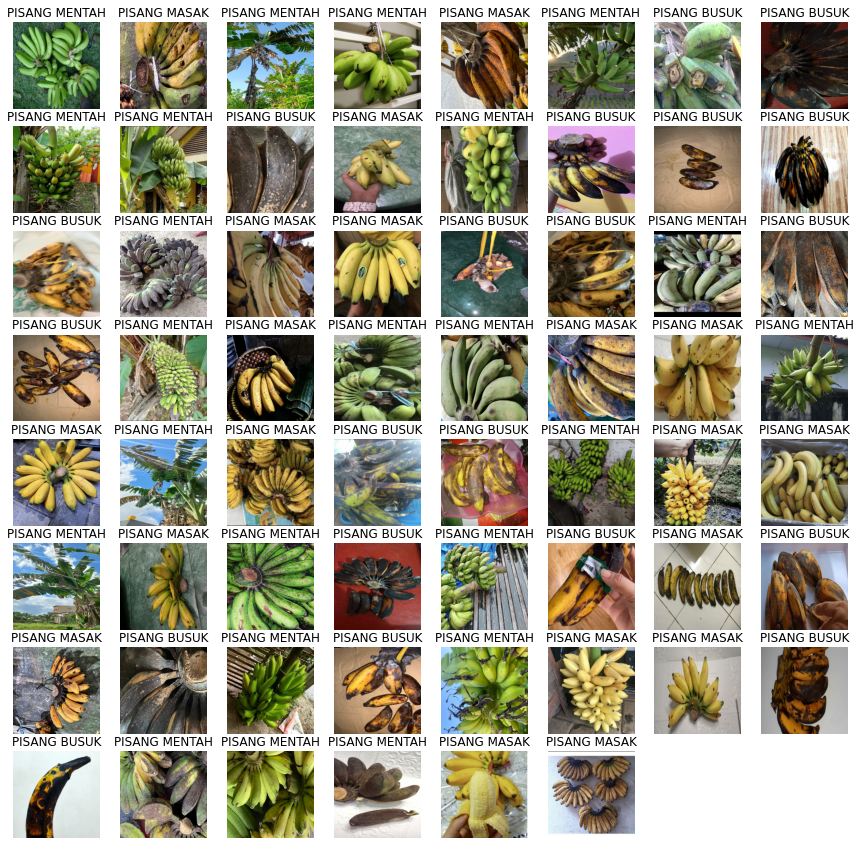

In [ ]:
plt.figure(figsize=(15, 15))
for image_batch, labels_batch in dataset.take(1):
    for i in range(BATCH_SIZE):
        ax = plt.subplot(8, 8, i + 1)
        plt.imshow(image_batch[i].numpy().astype("uint8"))
        plt.title(class_names[labels_batch[i]])
        plt.axis("off")

In [ ]:
def get_dataset_partitions_tf(ds, train_split=0.8, val_split=0.1, test_split=0.1, shuffle=True, shuffle_size=10000):
    assert (train_split + test_split + val_split) == 1
    ds_size = len(ds)
    if shuffle:
        ds = ds.shuffle(shuffle_size, seed=12)
    train_size = int(train_split * ds_size)
    val_size = int(val_split * ds_size)
    train_ds = ds.take(train_size)
    val_ds = ds.skip(train_size).take(val_size)
    test_ds = ds.skip(train_size).skip(val_size)
    # Autotune all the 3 datasets
    train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
    val_ds = val_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
    test_ds = test_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
    return train_ds, val_ds, test_ds

In [ ]:
train_ds, val_ds, test_ds = get_dataset_partitions_tf(dataset)

In [ ]:
resize_and_rescale = tf.keras.Sequential([
  layers.experimental.preprocessing.Resizing(IMAGE_SIZE, IMAGE_SIZE),
  layers.experimental.preprocessing.Rescaling(1./255),
])

In [ ]:
data_augmentation = tf.keras.Sequential([
  layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
  layers.experimental.preprocessing.RandomRotation(0.2),
])

In [ ]:
input_shape = (BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, CHANNELS)
n_classes = 9

model = models.Sequential([
    resize_and_rescale,
    # data_augmentation,
    layers.Conv2D(32, kernel_size = (3,3), activation='relu', input_shape=input_shape),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64,  kernel_size = (3,3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64,  kernel_size = (3,3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(n_classes, activation='softmax'),
])
model.build(input_shape=input_shape)

In [ ]:
model.compile(
    optimizer='adam',
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

In [ ]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (62, 256, 256, 3)         0         
                                                                 
 conv2d (Conv2D)             (62, 254, 254, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2D  (62, 127, 127, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (62, 125, 125, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (62, 62, 62, 64)         0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (62, 60, 60, 64)         

In [ ]:
history = model.fit(
    train_ds,
    batch_size=BATCH_SIZE,
    validation_data=val_ds,
    verbose=2,
    epochs=EPOCHS,
)

Epoch 1/62
4/4 - 21s - loss: 2.0028 - accuracy: 0.2731 - 21s/epoch - 5s/step
Epoch 2/62
4/4 - 1s - loss: 1.3212 - accuracy: 0.3782 - 511ms/epoch - 128ms/step
Epoch 3/62
4/4 - 0s - loss: 1.2294 - accuracy: 0.3445 - 445ms/epoch - 111ms/step
Epoch 4/62
4/4 - 0s - loss: 1.2620 - accuracy: 0.3613 - 452ms/epoch - 113ms/step
Epoch 5/62
4/4 - 0s - loss: 1.2132 - accuracy: 0.3529 - 444ms/epoch - 111ms/step
Epoch 6/62
4/4 - 0s - loss: 1.1992 - accuracy: 0.3782 - 442ms/epoch - 111ms/step
Epoch 7/62
4/4 - 0s - loss: 1.1058 - accuracy: 0.3319 - 443ms/epoch - 111ms/step
Epoch 8/62
4/4 - 0s - loss: 1.0871 - accuracy: 0.3908 - 443ms/epoch - 111ms/step
Epoch 9/62
4/4 - 0s - loss: 1.1357 - accuracy: 0.3235 - 444ms/epoch - 111ms/step
Epoch 10/62
4/4 - 0s - loss: 1.0878 - accuracy: 0.4202 - 445ms/epoch - 111ms/step
Epoch 11/62
4/4 - 0s - loss: 1.0862 - accuracy: 0.4034 - 443ms/epoch - 111ms/step
Epoch 12/62
4/4 - 0s - loss: 1.0435 - accuracy: 0.4748 - 445ms/epoch - 111ms/step
Epoch 13/62
4/4 - 0s - loss: 

In [ ]:
model.evaluate(test_ds)

1/1 [==============================] - 5s 5s/step - loss: 0.0514 - accuracy: 0.9839


[0.05142083391547203, 0.9838709831237793]

In [ ]:
acc = history.history['accuracy']
loss = history.history['loss']

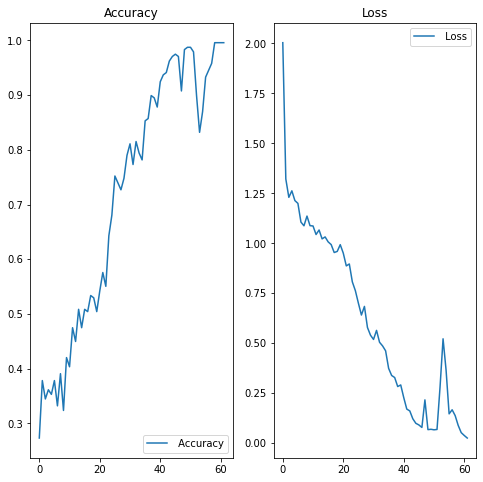

In [ ]:
plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(range(EPOCHS), acc, label=' Accuracy')
plt.legend(loc='lower right')
plt.title('Accuracy')

plt.subplot(1, 2, 2)
plt.plot(range(EPOCHS), loss, label=' Loss')
plt.legend(loc='upper right')
plt.title('Loss')
plt.show()

PISANG BUSUK


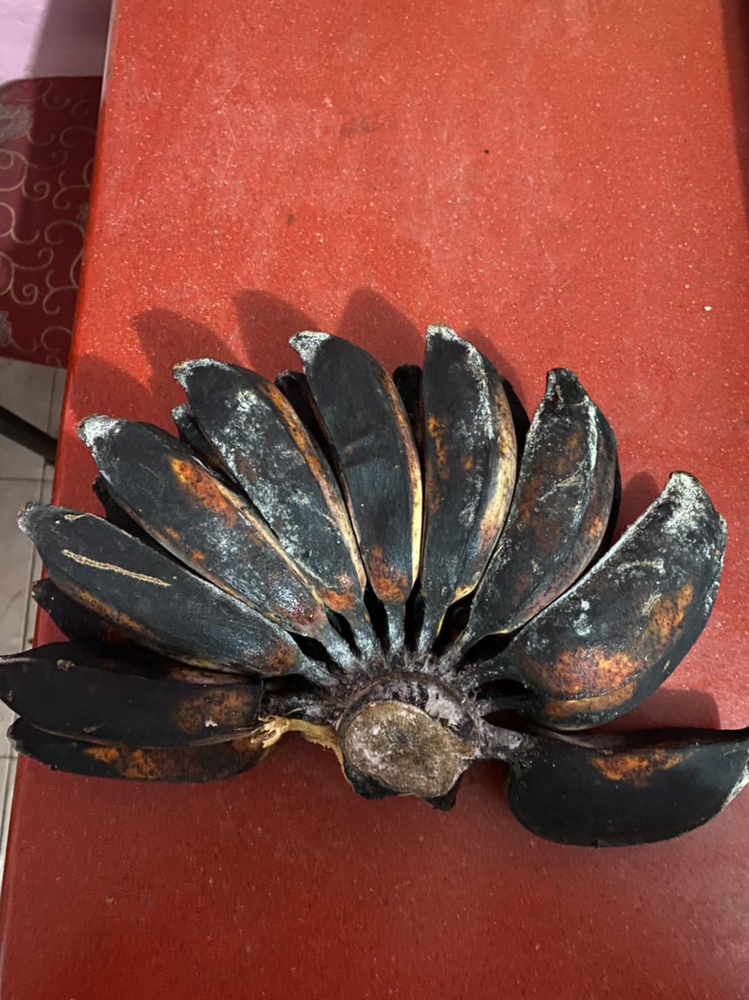

In [ ]:
image_path = "/content/TUGAS DEEP LEARNING/PISANG BUSUK/1654600539501.jpg"
image = preprocessing.image.load_img(image_path)
image_array = preprocessing.image.img_to_array(image)
scaled_img = np.expand_dims(image_array, axis=0)
pred = model.predict(scaled_img)
output = class_names[np.argmax(pred)]
print(output)
image

PISANG BUSUK


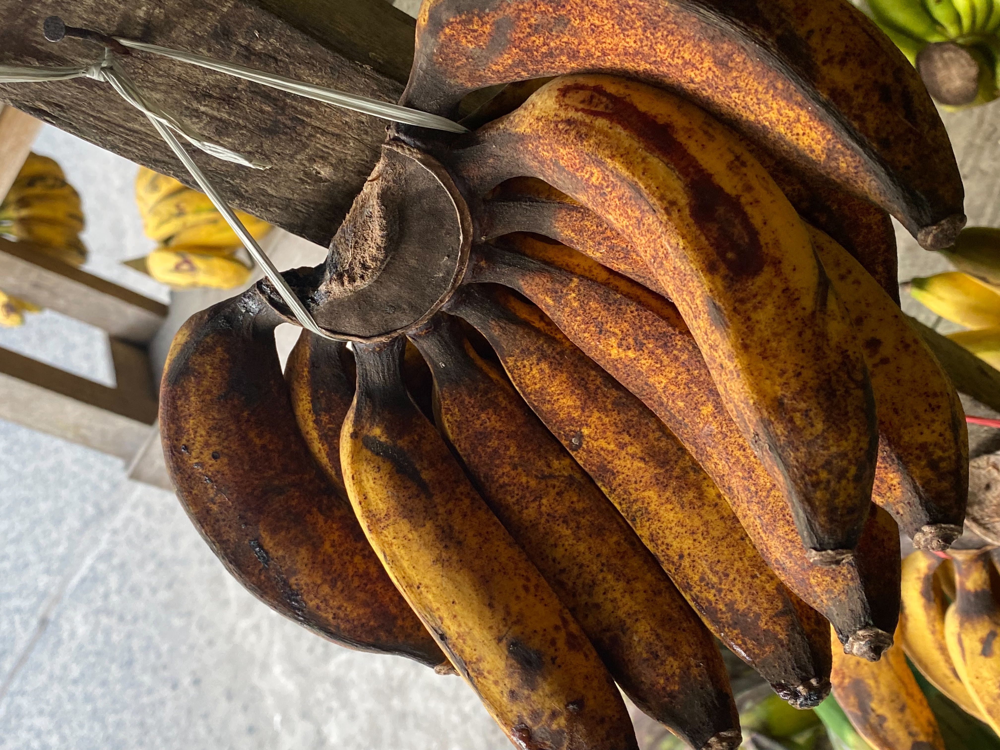

In [ ]:
image_path = "/content/TUGAS DEEP LEARNING/PISANG MASAK/1654600669652.jpg"
image2 = preprocessing.image.load_img(image_path)
image_array = preprocessing.image.img_to_array(image)
scaled_img = np.expand_dims(image_array, axis=0)
pred = model.predict(scaled_img)
output = class_names[np.argmax(pred)]
print(output)
image2

PISANG MASAK


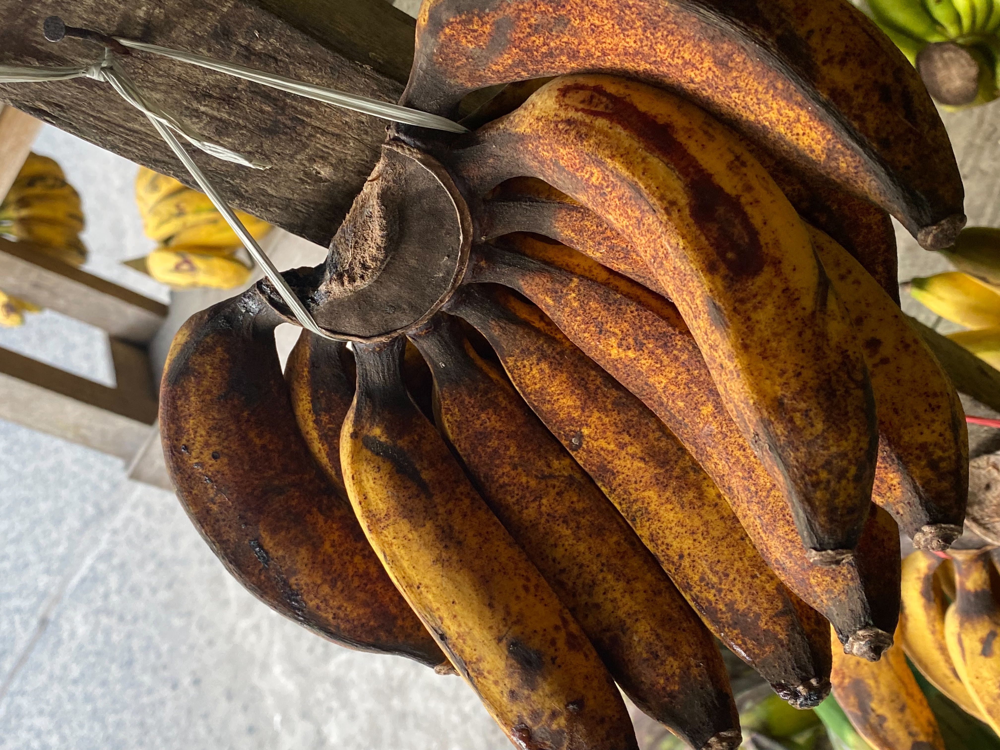

In [ ]:
image_path = "/content/TUGAS DEEP LEARNING/PISANG MASAK/1654600669652.jpg"
image = preprocessing.image.load_img(image_path)
image_array = preprocessing.image.img_to_array(image)
scaled_img = np.expand_dims(image_array, axis=0)
pred = model.predict(scaled_img)
output = class_names[np.argmax(pred)]
print(output)
image

In [ ]:
model.save("Klasifikasi Tingkat Kematangan Pisang.h5")